In [93]:
import pandas as pd
from pathlib import Path
import re
import json
from collections import defaultdict,  Counter
import matplotlib.pyplot as plt
import datetime
import random
from zipfile import ZipFile
from pathlib import Path
import xml.etree.ElementTree as ET
from collections import Counter
from tqdm.notebook import tqdm, trange

In [98]:
search_results_path = Path('f:/datasets/PRV_KEMI_DATA/ipc_search')
search_results_files = list(search_results_path.glob('*.txt'))
len(search_results_files)

417

In [79]:
p = Path('F:/datasets/PRV_KEMI_DATA/patents') /'downloaded_netto_list_patents.txt'
with open(p) as fp:
    netto_list_patents = set(line.strip() for line in fp)
len(netto_list_patents)

15525

In [80]:
def load_patent_xml(patent_path):
    with ZipFile(patent_path) as patent_zip:
        filenames = [zipinfo.filename for zipinfo in patent_zip.infolist()]
        # We're just assuming the only XML apart from TOC.xml is the one we're looking for
        # Since the name of this document is based on the application number, not the 
        # publication number, we have to scan for it manually
        doc_xml = None
        for filename in filenames:
            *base, ext = filename.split('.')
            if ext == 'xml' and filename.lower() != 'toc.xml':
                doc_xml = filename
        if doc_xml is None:
            raise ValueError(f"Unable to find document xml for zipfile {patent_path}")
        
        with patent_zip.open(doc_xml) as patent_xml_fp:
            xml_str = str(patent_xml_fp.read(), encoding='utf8')
            root = ET.fromstring(xml_str)
            return root

In [81]:
def extract_patent_info(patent_path):
    patent_info = dict()
    root = load_patent_xml(patent_path)
    # The root element is the 'ep-patent-document', which has an attribute called date-publ, the publication date
    publication_date_str = root.attrib['date-publ']
    publication_date = datetime.datetime.strptime(publication_date_str, '%Y%m%d')
    patent_info['publication_date'] = publication_date

    doc_country = root.attrib['country']
    doc_number = root.attrib['doc-number']
    doc_kind = root.attrib['kind']
    patent_info['document_number'] = f'{doc_country}{doc_number}.{doc_kind}'

    ipcr_classes = root.findall('.//SDOBI//classification-ipcr/text')
    text_classes = [e.text for e in ipcr_classes]
    # The class string has the form 'A61K  38/44        20060101AFI20130522BHEP        '
    # We first split by white space and only select the first two parts
    split_classes = [text.split() for text in text_classes]
    selected_parts = [(main_class, sub_class) for main_class, sub_class, *_ in split_classes]
    patent_info['ipc_classes'] = selected_parts

    return patent_info

In [82]:
p = search_results_files[56]
m = re.match(r'([\w\d]+)_(\d+)-(\d+)\.txt', p.name)
ipc_class, start_date, end_date = m.groups()
datetime.datetime.strptime(start_date, '%Y%m%d').year

2016

In [57]:
with open(search_results_files[56]) as fp:
    search_results = fp.read()

In [99]:
def load_search_results(search_result_path):
    m = re.match(r'([\w\d]+)_(\d+)-(\d+)\.txt', search_result_path.name)
    if m is not None:
        ipc_class, begin_date_str, end_date = m.groups()
        begin_date = datetime.datetime.strptime(begin_date_str, '%Y%m%d')
        with open(search_result_path) as fp:
            patent_numbers = [line.strip() for line in fp]
        return {ipc_class: {begin_date.year: patent_numbers}}
    else:
        print("not a match")
        return None




In [101]:
collated_search_results = defaultdict(lambda: defaultdict(set))
for results_path in search_results_files:
    class_docs = load_search_results(results_path)
    if class_docs is not None:
        for ipc_class, yearly_docs in class_docs.items():
            for year, docs in yearly_docs.items():
                collated_search_results[year][ipc_class].update(docs)
collated_search_results

defaultdict(<function __main__.<lambda>()>,
            {2010: defaultdict(set,
                         {'A61K': {'EP2191000.A1',
                           'EP2209896.A2',
                           'EP2167058.A2',
                           'EP2192114.A1',
                           'EP2249921.A2',
                           'EP2230910.A1',
                           'EP2248901.A1',
                           'EP2205265.A1',
                           'EP2216046.A2',
                           'EP2170961.A1',
                           'EP2257526.A1',
                           'EP2230254.A2',
                           'EP2217231.A1',
                           'EP2252307.A2',
                           'EP2155192.A2',
                           'EP2220065.A2',
                           'EP2161578.A1',
                           'EP2155198.A2',
                           'EP2176220.A2',
                           'EP2173353.A1',
                           'EP2223934.A1',
         

In [100]:
collated_complement_search_results = defaultdict(lambda: defaultdict(set))
for results_path in search_results_files:
    class_docs = load_search_results(results_path)
    if class_docs is not None:
        for ipc_class, yearly_docs in class_docs.items():
            for year, docs in yearly_docs.items():
                filtered_docs = [doc for doc in docs if doc not in netto_list_patents]
                collated_complement_search_results[year][ipc_class].update(filtered_docs)
collated_complement_search_results

defaultdict(<function __main__.<lambda>()>,
            {2010: defaultdict(set,
                         {'A61K': {'EP2191000.A1',
                           'EP2209896.A2',
                           'EP2167058.A2',
                           'EP2192114.A1',
                           'EP2249921.A2',
                           'EP2230910.A1',
                           'EP2248901.A1',
                           'EP2205265.A1',
                           'EP2216046.A2',
                           'EP2170961.A1',
                           'EP2257526.A1',
                           'EP2230254.A2',
                           'EP2217231.A1',
                           'EP2252307.A2',
                           'EP2155192.A2',
                           'EP2220065.A2',
                           'EP2161578.A1',
                           'EP2155198.A2',
                           'EP2176220.A2',
                           'EP2173353.A1',
                           'EP2223934.A1',
         

In [88]:
yearly_ipc_class_counts = {year: {ipc_class: len(docs) for ipc_class, docs in ipc_docs.items()} for year, ipc_docs in collated_search_results.items()}


In [74]:
years = sorted(set([year for yearly_counts in ipc_class_yearly_counts.values() for year, counts in yearly_counts.items()]))
years

[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021]

In [35]:
x, years = zip(*enumerate(years))
x, years

((0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11),
 ('2010',
  '2011',
  '2012',
  '2013',
  '2014',
  '2015',
  '2016',
  '2017',
  '2018',
  '2019',
  '2020',
  '2021'))

In [75]:
ipc_class = next(iter(ipc_class_yearly_counts.keys()))
ipc_class = 'C08L'
collated_search_results[ipc_class]['2010']

[]

([<matplotlib.axis.XTick at 0x294b5ccad30>,
 [Text(0, 0, '2010'),
  Text(1, 0, '2011'),
  Text(2, 0, '2012'),
  Text(3, 0, '2013'),
  Text(4, 0, '2014'),
  Text(5, 0, '2015'),
  Text(6, 0, '2016'),
  Text(7, 0, '2017'),
  Text(8, 0, '2018'),
  Text(9, 0, '2019'),
  Text(10, 0, '2020'),
  Text(11, 0, '2021')])

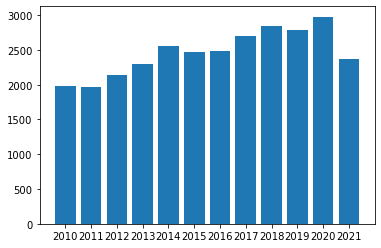

In [76]:
years, y = zip(*sorted(ipc_class_yearly_counts[ipc_class].items()))
plt.bar(x, y, label=ipc_class)
plt.xticks(x, years)

In [40]:
y

(0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)

In [146]:
sample_ratio = 1.1
p = Path('F:/datasets/PRV_KEMI_DATA/') / f'desired_sample_size_with_sample_ratio_{sample_ratio}.json'
with open(p) as fp:
    desired_sample_size = json.load(fp)

In [147]:
sum(count for year, class_counts in desired_sample_size.items() for ipc_class, count in class_counts.items())

17074

In [148]:
random_seed = 1729
random.seed(random_seed)
sampled_complement_docs = defaultdict(lambda: defaultdict(set))
error_on_small_sample_size = True

for year, class_sample_sizes in desired_sample_size.items():
    for ipc_class, class_sample_size in class_sample_sizes.items():
        docs = collated_complement_search_results[int(year)][ipc_class]
        if len(docs) < class_sample_size:
            error_str = f"The number of documents ({len(docs)}) for class {ipc_class} is less than the desired sample size {class_sample_size} for year {year}"
            
            if error_on_small_sample_size:
                raise ValueError(error_str)
            else:
                print(error_str)
                sampled_docs = docs
        else:
            sampled_docs = random.sample(list(docs), class_sample_size)
            sampled_complement_docs[year][ipc_class] = sampled_docs


In [149]:
collected_sampled_complement_docs = set()
for year, class_docs in sampled_complement_docs.items():
    for ipc_class, docs in class_docs.items():
        collected_sampled_complement_docs.update(docs)
len(collected_sampled_complement_docs)

15902

{'EP2679661.A1',
 'EP2681297.A1',
 'EP2682451.A1',
 'EP2683802.A1',
 'EP2684942.A1',
 'EP2687581.A1',
 'EP2687583.A1',
 'EP2687584.A1',
 'EP2687585.A1',
 'EP2687761.A1',
 'EP2688988.A2',
 'EP2688989.A1',
 'EP2688990.A2',
 'EP2690163.A1',
 'EP2690165.A1',
 'EP2691500.A2',
 'EP2692839.A1',
 'EP2692841.A1',
 'EP2694631.A1',
 'EP2694632.A2',
 'EP2695932.A1',
 'EP2697344.A1',
 'EP2698418.A1',
 'EP2698419.A1',
 'EP2698421.A1',
 'EP2702101.A1',
 'EP2702122.A1',
 'EP2702124.A1',
 'EP2702125.A1',
 'EP2703475.A1',
 'EP2703477.A2',
 'EP2705126.A1',
 'EP2705127.A1',
 'EP2706104.A1',
 'EP2707468.A1',
 'EP2707469.A1',
 'EP2707470.A1',
 'EP2708617.A1',
 'EP2714814.A2',
 'EP2714857.A1',
 'EP2714858.A1',
 'EP2714867.A1',
 'EP2715320.A2',
 'EP2719750.A1',
 'EP2720232.A1',
 'EP2721127.A1',
 'EP2722384.A1',
 'EP2723835.A1',
 'EP2723837.A1',
 'EP2723839.A1',
 'EP2726695.A1',
 'EP2727982.A1',
 'EP2727984.A1',
 'EP2729555.A1',
 'EP2733191.A1',
 'EP2733192.A1',
 'EP2734608.A1',
 'EP2735574.A1',
 'EP2735603.A1